# Data Exploration

# Resources

1. Lily's notebook: https://colab.research.google.com/drive/1KniWKaa-_8y-0AgXdq3Hk7dmpwcdIl0L#scrollTo=gctkkixPfecd
2. GliderTools documentation: https://glidertools.readthedocs.io/en/latest/quality_control.html
3. CMOcean documentation: https://matplotlib.org/cmocean/
4. GSW documentation: https://www.teos-10.org/pubs/gsw/html/gsw_contents.html
5. SLA Data Source: https://data.marine.copernicus.eu/product/SEALEVEL_GLO_PHY_L4_NRT_008_046/description 


# Imports and Loading Data

In [1]:
import glidertools as gt
from cmocean import cm as cmo
import gsw

In [2]:
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib.animation as animation
import matplotlib.cm as cm
import xarray as xr

In [3]:
# Load glider data files from local
filenames = './data/p6590*.nc'

# Load just one file
firstNC = xr.open_dataset('./data/p6590003.nc')

# Load SLA file from local
slaFilename = './data/cmems_obs-sl_glo_phy-ssh_nrt_allsat-l4-duacs-0.25deg_P1D_1707887583099.nc'

In [12]:
# Can comment out: show the variables (there's a lot)
gt.load.seaglider_show_variables(filenames)

information is based on file: ./data/p6590186.nc


,dims,units,comment
name,,,
aa4831_AirSat,aa4831_data_point,,As reported by the instrument
aa4831_CalPhase,aa4831_data_point,,As reported by the instrument
aa4831_O2,aa4831_data_point,micromoles/L,"Dissolved oxygen as reported by the instument, based on on-board calibration data, assuming optode temperature but without depth or salinity correction"
aa4831_TCPhase,aa4831_data_point,,As reported by the instrument
aa4831_Temp,aa4831_data_point,degrees_Celsius,As reported by the instrument
aa4831_time,aa4831_data_point,seconds since 1970-1-1 00:00:00,aa4831 time in GMT epoch format
aanderaa4831_dissolved_oxygen,aa4831_data_point,micromoles/kg,"Dissolved oxygen concentration, calculated from optode tcphase corrected for salininty and depth"
aanderaa4831_dissolved_oxygen_qc,aa4831_data_point,,Whether to trust each optode dissolved oxygen value
aanderaa4831_instrument_dissolved_oxygen,aa4831_data_point,micromoles/kg,Dissolved oxygen concentration reported from optode corrected for salinity


# Accessing Variables

In [4]:
# Load these variables from the files into ds_dict

names = [
    'ctd_depth',
    'ctd_time',
    'ctd_pressure',
    'salinity_raw',
    'temperature',
    'dissolved_oxygen_sat',
    'wlbb2fl_BB1sig',
    'wlbb2fl_BB2sig',
    'wlbb2fl_FL2sig',
    'aa4831_O2',
    'aanderaa4831_results_time_dt64',
    'aanderaa4831_instrument_dissolved_oxygen'
]

ds_dict = gt.load.seaglider_basestation_netCDFs(
    filenames, names,
    #return_merged=True,
    keep_global_attrs=False
)

# Can comment out if needed
ds_dict

/Users/ayushmanc/opt/anaconda3/lib/python3.9/site-packages/glidertools/load/seaglider.py:224: GliderToolsWarning: aanderaa4831_results_time_dt64 was not found in the files
  warnings.warn(msg, GliderToolsWarning)



DIMENSION: ctd_data_point
{dissolved_oxygen_sat, ctd_time, longitude, salinity_raw, ctd_pressure, latitude, temperature, ctd_depth}


100%|██████████| 366/366 [00:02<00:00, 151.99it/s]



DIMENSION: wlbb2fl_data_point
{wlbb2fl_time, wlbb2fl_FL2sig, wlbb2fl_BB2sig, wlbb2fl_BB1sig}


100%|██████████| 366/366 [00:01<00:00, 237.03it/s]



DIMENSION: aa4831_data_point
{aa4831_time, aanderaa4831_instrument_dissolved_oxygen, aa4831_O2}


100%|██████████| 366/366 [00:01<00:00, 249.40it/s]


{'ctd_data_point': <xarray.Dataset>
 Dimensions:               (ctd_data_point: 876256)
 Coordinates:
     ctd_time_dt64         (ctd_data_point) datetime64[ns] 2023-11-26T23:26:04...
     longitude             (ctd_data_point) float64 152.0 152.0 ... 152.9 152.9
     latitude              (ctd_data_point) float64 -55.9 -55.9 ... -53.54 -53.54
     ctd_depth             (ctd_data_point) float64 1.399 1.325 ... 0.121 0.2565
 Dimensions without coordinates: ctd_data_point
 Data variables:
     dissolved_oxygen_sat  (ctd_data_point) float64 nan nan nan ... nan nan nan
     ctd_time              (ctd_data_point) float64 1.701e+09 ... 1.706e+09
     salinity_raw          (ctd_data_point) float64 33.75 33.75 ... 33.5 33.7
     ctd_pressure          (ctd_data_point) float64 2.004 1.93 ... 0.3894 0.53
     temperature           (ctd_data_point) float64 2.147 2.148 ... 5.912 5.928
     dives                 (ctd_data_point) float64 3.0 3.0 3.0 ... 370.5 370.5
 Attributes:
     date_created:    

In [15]:
aa_data_table = ds_dict['aa4831_data_point']

aa_data_table

<xarray.Dataset>
Dimensions:                                   (aa4831_data_point: 655433)
Dimensions without coordinates: aa4831_data_point
Data variables:
    aa4831_time_dt64                          (aa4831_data_point) datetime64[ns] ...
    aa4831_time                               (aa4831_data_point) float64 1.7...
    aanderaa4831_instrument_dissolved_oxygen  (aa4831_data_point) float64 nan...
    aa4831_O2                                 (aa4831_data_point) float64 439...
    dives                                     (aa4831_data_point) int32 3 ......
Attributes:
    date_created:             2024-05-01 16:10:44
    number_of_dives:          370
    files:                    ['p6590003.nc', 'p6590004.nc', 'p6590005.nc', '...
    time_coverage_start:      2023-11-26 23:26:05
    time_coverage_end:        2024-01-22 16:04:38
    geospatial_vertical_min:  nan
    geospatial_vertical_max:  nan
    geospatial_lat_min:       nan
    geospatial_lat_max:       nan
    geospatial_lon_min:       nan
    geospatial_lon_max:       nan
    processing:               [2024-05-01 16:10:44] imported data with Glider...

In [16]:
# Get the data points from ds_dict, and rename the names

ctd_data_table = ds_dict['ctd_data_point']

wlbb2fl_data_table = ds_dict['wlbb2fl_data_point']

aa_data_table = ds_dict['aa4831_data_point']

dat = ctd_data_table.rename({
    'salinity_raw': 'salt_raw',
    'ctd_pressure': 'pressure',
    'ctd_time': 'time_raw',
    'temperature': 'temp_raw',
    'ctd_depth': 'depth',
    'dissolved_oxygen_sat':'oxygen'
})

wlbb2fl_dat = wlbb2fl_data_table.rename({
    'wlbb2fl_BB1sig':'chlorophyll_voltage',
    'wlbb2fl_BB2sig':'backscatter_voltage',
    'wlbb2fl_FL2sig':'cdom_voltage'
})

aa_dat = aa_data_table.rename({
    'aa4831_time_dt64':'datetime',
    'aanderaa4831_instrument_dissolved_oxygen':'dissolved_oxygen',
})

In [7]:
# Get scaleFactor and darkCounts for the chlorophyll, backscatter, cdom data collected above

chlorophyll_scaleFactor = firstNC.sg_cal_WETLabsCalData_wlbbfl2_Chlorophyll_scaleFactor
chlorophyll_darkCounts = firstNC.sg_cal_WETLabsCalData_wlbbfl2_Chlorophyll_darkCounts
backscatter_scaleFactor = firstNC.sg_cal_WETLabsCalData_wlbbfl2_Scatter700_scaleFactor
backscatter_darkCounts = firstNC.sg_cal_WETLabsCalData_wlbbfl2_Scatter700_darkCounts
cdom_scaleFactor = firstNC.sg_cal_WETLabsCalData_wlbbfl2_CDOM_scaleFactor
cdom_darkCounts = firstNC.sg_cal_WETLabsCalData_wlbbfl2_CDOM_darkCounts

# 1D Time Serieses

In [8]:
# Set up plots
figWindow = (18,3)
xRange = (0, 370)

# Define x and y for graph. Ensure they are numpy arrays
x = np.array(dat.dives)
y = np.array(dat.depth)
gliderDates = list(map(lambda x: np.datetime_as_string(x, unit='D'), dat.ctd_time_dt64.values))

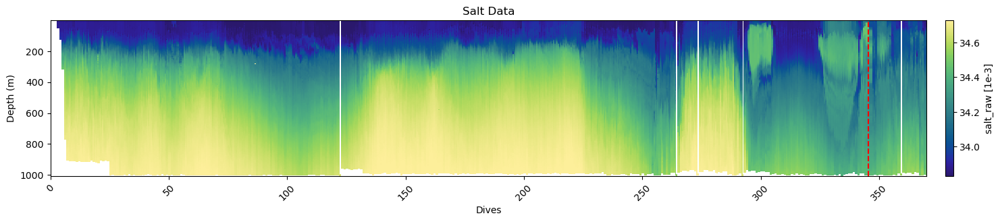

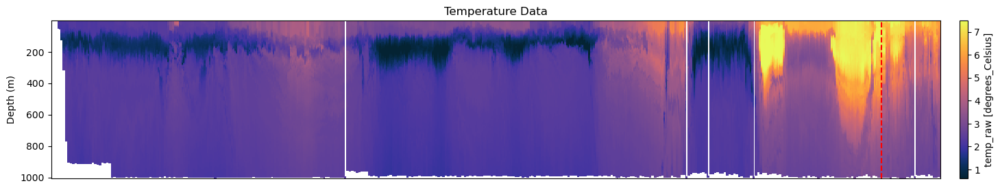

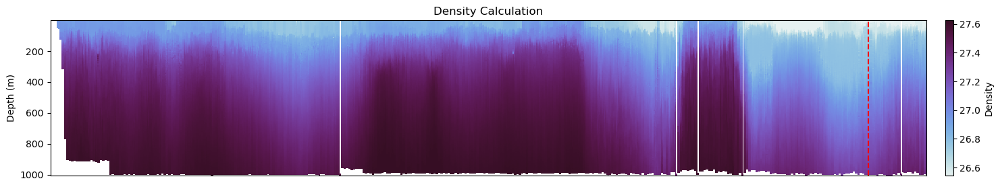

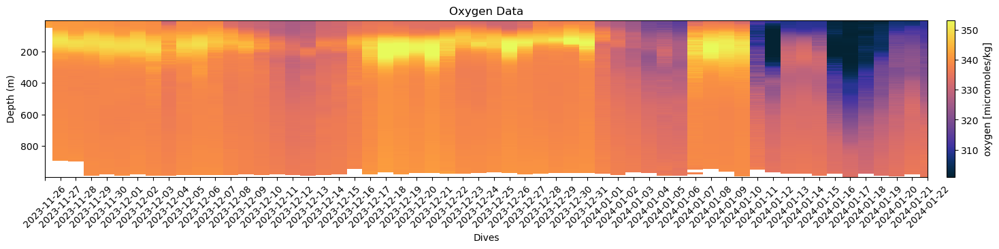

In [9]:
# Plot Salt
plt.figure(figsize=figWindow)
gt.plot(x, y, dat.salt_raw, cmap=cmo.haline, robust=True)
plt.title('Salt Data')
plt.xlim(xRange)
plt.axvline(x=345.5, color='red', linestyle='--')
plt.show()

# Plot Temperature
plt.figure(figsize=figWindow)
gt.plot(x, y, dat.temp_raw, cmap=cmo.thermal, robust=True)
plt.title('Temperature Data')
plt.xlim(xRange)
plt.axvline(x=345.5, color='red', linestyle='--')
plt.xticks([])
plt.xlabel("")
plt.show()

# Plot Density
rho = gsw.sigma0(dat.salt_raw, dat.temp_raw)
plt.figure(figsize=figWindow)
ax = gt.plot(x,y, rho, cmap=cmo.dense, robust=True)
cbar = ax.collections[0].colorbar
cbar.set_label('Density')
plt.title('Density Calculation')
plt.xlim(xRange)
plt.axvline(x=345.5, color='red', linestyle='--')
plt.xticks([])
plt.xlabel("")
plt.show()

# Later - aa_data_table.aa4831_O2


plt.figure(figsize=figWindow)
gt.plot(gliderDates, y, dat.oxygen, cmap=cmo.thermal, robust=True)
plt.title('Oxygen Data')
#plt.xlim(xRange)
#plt.axvline(x=345.5, color='red', linestyle='--')
plt.show()




In [17]:
aa_dat

<xarray.Dataset>
Dimensions:           (aa4831_data_point: 655433)
Dimensions without coordinates: aa4831_data_point
Data variables:
    datetime          (aa4831_data_point) datetime64[ns] 2023-11-26T23:26:05 ...
    aa4831_time       (aa4831_data_point) float64 1.701e+09 ... 1.706e+09
    dissolved_oxygen  (aa4831_data_point) float64 nan nan nan ... nan nan nan
    aa4831_O2         (aa4831_data_point) float64 439.3 439.0 ... 391.7 390.6
    dives             (aa4831_data_point) int32 3 3 3 3 3 ... 370 370 370 370
Attributes:
    date_created:             2024-05-01 16:10:44
    number_of_dives:          370
    files:                    ['p6590003.nc', 'p6590004.nc', 'p6590005.nc', '...
    time_coverage_start:      2023-11-26 23:26:05
    time_coverage_end:        2024-01-22 16:04:38
    geospatial_vertical_min:  nan
    geospatial_vertical_max:  nan
    geospatial_lat_min:       nan
    geospatial_lat_max:       nan
    geospatial_lon_min:       nan
    geospatial_lon_max:       nan
    processing:               [2024-05-01 16:10:44] imported data with Glider...

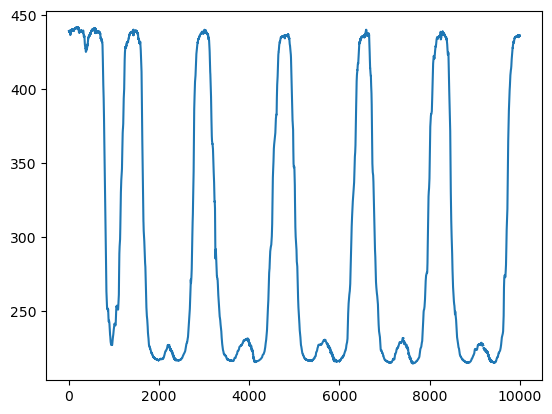

In [45]:
plt.plot(aa_data_table.aa4831_O2[0:10000])

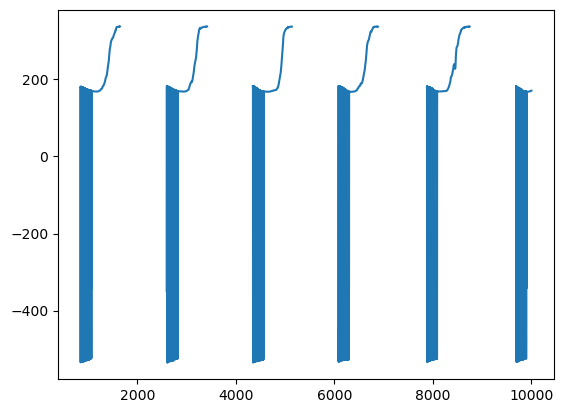

In [18]:
plt.plot(aa_dat.dissolved_oxygen[10000:20000])

In [63]:
# How many nan values are there??
print(np.mean(np.isnan(aa_dat.dissolved_oxygen.values)), np.mean(np.isnan(aa_dat.aa4831_O2.values)))

len(np.argwhere(np.isnan(aa_dat.aa4831_O2.values)))

0.5039584518936336 0.0018308507505725223


1200

Times are different, between aa and ctd

Linear interpolation, to the aa times (higher resolution to lower resolution)

Goal: get o2sol times (salt, pressure, etc.) in the aa times so that the division is in the same dimension

Also map / interpolate so that dive/depth work

Use the aa4831_o2 numbers

In [57]:
print(dat.ctd_time_dt64.values[1:10])

print(aa_dat.datetime.values[1:10])

print(len(dat.ctd_time_dt64.values), len(aa_dat.datetime.values), aa_dat.dissolved_oxygen[42])

['2023-11-26T23:26:08.000000000' '2023-11-26T23:26:13.000000000'
 '2023-11-26T23:26:18.000000000' '2023-11-26T23:26:23.000000000'
 '2023-11-26T23:26:28.000000000' '2023-11-26T23:26:33.000000000'
 '2023-11-26T23:26:38.000000000' '2023-11-26T23:26:43.000000000'
 '2023-11-26T23:26:48.000000000']
['2023-11-26T23:26:09.000000000' '2023-11-26T23:26:14.000000000'
 '2023-11-26T23:26:19.000000000' '2023-11-26T23:26:24.000000000'
 '2023-11-26T23:26:29.000000000' '2023-11-26T23:26:34.000000000'
 '2023-11-26T23:26:39.000000000' '2023-11-26T23:26:44.000000000'
 '2023-11-26T23:26:49.000000000']
876256 655433 <xarray.DataArray 'dissolved_oxygen' ()>
array(nan)
Attributes:
    units:       micromoles/kg
    _FillValue:  nan
    instrument:  aa4831
    comment:     Dissolved oxygen concentration reported from optode correcte...
    platform:    glider


In [52]:
absoluteSalinity = gsw.SA_from_SP(dat.salt_raw, dat.pressure, dat.longitude, dat.latitude)
conservativeTemp = gsw.CT_from_t(absoluteSalinity, dat.temp_raw, dat.pressure)
o2sol = gsw.O2sol(absoluteSalinity, conservativeTemp, dat.pressure, dat.longitude, dat.latitude)
o2sol

<xarray.DataArray 'salt_raw' (ctd_data_point: 876256)>
array([332.5526692 , 332.54735922, 332.53198158, ..., 340.15637057,
       304.22932031, 303.65783797])
Coordinates:
    ctd_time_dt64  (ctd_data_point) datetime64[ns] 2023-11-26T23:26:04 ... 20...
    depth          (ctd_data_point) float64 1.399 1.325 1.408 ... 0.121 0.2565
    longitude      (ctd_data_point) float64 152.0 152.0 152.0 ... 152.9 152.9
    latitude       (ctd_data_point) float64 -55.9 -55.9 -55.9 ... -53.54 -53.54
Dimensions without coordinates: ctd_data_point
Attributes:
    units:     1e-3
    comment:   Uncorrected salinity derived from temperature_raw and conducti...
    platform:  glider

In [128]:
# DON"T RUN THIS - Takes a while, because of the division mismatch

o2saturation = (aa_data_table.aanderaa4831_instrument_dissolved_oxygen / o2sol) * 100
plt.figure(figsize=figWindow)
gt.plot(x, y, o2saturation, cmap=cmo.thermal, robust=True)
plt.title('Oxygen Saturation Data')
plt.xlim(xRange)
plt.axvline(x=345.5, color='red', linestyle='--')
plt.show()

get hourly granularity (or smaller than day)

Decimal days (still associated with time)

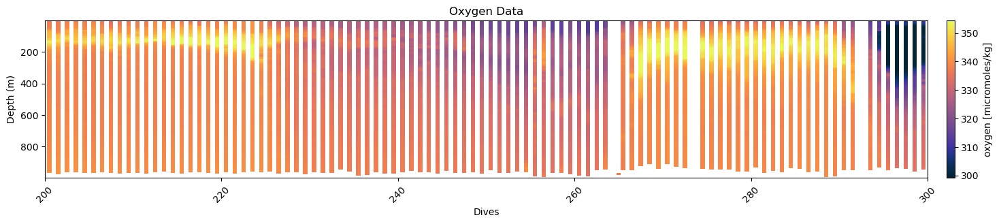

In [13]:
plt.figure(figsize=figWindow)
gt.plot(x, y, dat.oxygen, cmap=cmo.thermal, robust=True)
plt.title('Oxygen Data')
plt.xlim((200, 300))
plt.show()

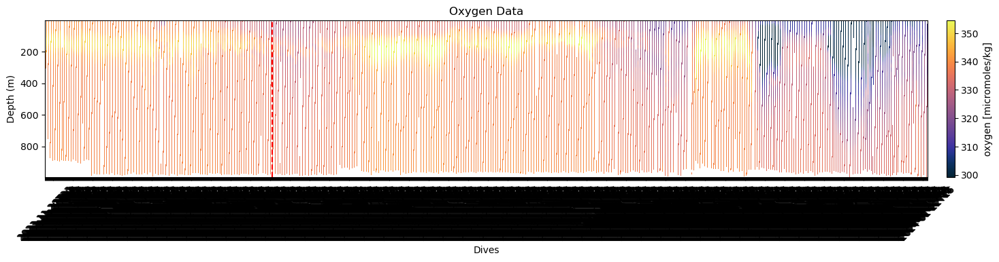

In [14]:
gliderHours = list(map(lambda x: np.datetime_as_string(x, unit='h'), dat.ctd_time_dt64.values))
# Plot Oxygen
plt.figure(figsize=figWindow)
gt.plot(np.array(gliderHours), y, dat.oxygen, cmap=cmo.thermal, robust=True)
plt.title('Oxygen Data')
plt.axvline(x=345.5, color='red', linestyle='--')
plt.show()

New strategy - interpolation

In [14]:
subset = dat.isel(ctd_data_point = slice(0,500))
subset = subset.where(subset['oxygen'].notnull(), drop=True)
subset

<xarray.Dataset>
Dimensions:        (ctd_data_point: 173)
Coordinates:
    ctd_time_dt64  (ctd_data_point) datetime64[ns] 2023-11-26T23:38:30 ... 20...
    depth          (ctd_data_point) float64 40.93 40.47 39.97 ... 56.81 56.07
    longitude      (ctd_data_point) float64 152.0 152.0 152.0 ... 152.0 152.0
    latitude       (ctd_data_point) float64 -55.9 -55.9 -55.9 ... -55.89 -55.89
Dimensions without coordinates: ctd_data_point
Data variables:
    oxygen         (ctd_data_point) float64 342.0 342.0 342.0 ... 342.1 342.1
    salt_raw       (ctd_data_point) float64 33.89 33.89 33.89 ... 33.89 33.89
    temp_raw       (ctd_data_point) float64 2.054 2.053 2.053 ... 2.041 2.043
    time_raw       (ctd_data_point) float64 1.701e+09 1.701e+09 ... 1.701e+09
    pressure       (ctd_data_point) float64 41.28 40.82 40.32 ... 57.28 56.54
    dives          (ctd_data_point) float64 3.5 3.5 3.5 3.5 ... 4.5 4.5 4.5 4.5
Attributes:
    date_created:             2024-04-03 11:20:45
    number_of_dives:          370.0
    files:                    ['p6590003.nc', 'p6590004.nc', 'p6590005.nc', '...
    time_coverage_start:      2023-11-26 23:26:04
    time_coverage_end:        2024-01-22 16:04:38
    geospatial_vertical_min:  -0.28922753099461745
    geospatial_vertical_max:  1001.6418512251538
    geospatial_lat_min:       -56.45904329886829
    geospatial_lat_max:       -53.179958844058284
    geospatial_lon_min:       151.28540296191383
    geospatial_lon_max:       156.6823154697159
    processing:               [2024-04-03 11:20:45] imported data with Glider...

In [15]:
xi = np.linspace(min(subset.ctd_time_dt64), max(subset.ctd_time_dt64), 400)
yi = np.linspace(min(subset.depth), max(subset.depth), 400)

interpolated_data = gt.mapping.interp_obj(subset.ctd_time_dt64, subset.depth, subset.oxygen, xi, yi)

UFuncTypeError: ufunc 'multiply' cannot use operands with types dtype('<M8[ns]') and dtype('float64')

Timing:

269 pts --> 45.2 seconds

1304 pts --> 2m 27.4 seconds

<AxesSubplot: xlabel='Dives', ylabel='Depth (m)'>

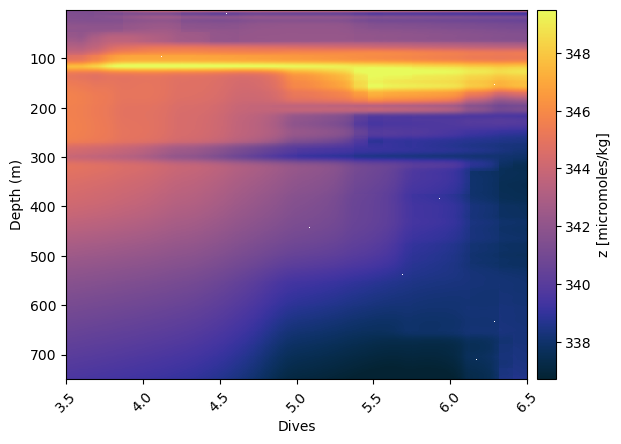

In [113]:
gt.plot.pcolormesh(interpolated_data.z, cmap=cmo.thermal)

# Mixed Layer

In [54]:
# Check that the dive numbers are in order

# The dives are in order - don't have to check again, takes 12 seconds to run
# for i in np.arange(dat.dives.values.size - 1):
#     if i % 100000 == 0:
#         print(i)
#     if dat.dives.values[i] > dat.dives.values[i+1]:
#         print("out of order!")


0
100000
200000
300000
400000
500000
600000
700000
800000


In [14]:
# Get the indices that correspond to each dive, for easier searching later
diveNums = np.unique(dat.dives.values)
diveIndices = []

for diveNum in diveNums:
    thisdiveIndices = np.where(dat.dives.values == diveNum)[0]
    diveIndices.append(
        (thisdiveIndices[0], thisdiveIndices[-1])
    )

print(diveIndices)

[(0, 113), (114, 220), (221, 372), (373, 589), (590, 947), (948, 1437), (1438, 2360), (2361, 3309), (3310, 4581), (4582, 5645), (5646, 6807), (6808, 7956), (7957, 9102), (9103, 10180), (10181, 11343), (11344, 12410), (12411, 13537), (13538, 14615), (14616, 15848), (15849, 16941), (16942, 18128), (18129, 19190), (19191, 20415), (20416, 21480), (21481, 22737), (22738, 23839), (23840, 25060), (25061, 26174), (26175, 27487), (27488, 28510), (28511, 29708), (29709, 30777), (30778, 31986), (31987, 33084), (33085, 34378), (34379, 35470), (35471, 36582), (36583, 37550), (37551, 38723), (38724, 39737), (39738, 40931), (40932, 42003), (42004, 43235), (43236, 44281), (44282, 45662), (45663, 46882), (46883, 48246), (48247, 49443), (49444, 50925), (50926, 52148), (52149, 53565), (53566, 54766), (54767, 56107), (56108, 57255), (57256, 58631), (58632, 59815), (59816, 61163), (61164, 62316), (62317, 63714), (63715, 64914), (64915, 66296), (66297, 67462), (67463, 68891), (68892, 70129), (70130, 71563),

In [15]:
# For each dive, compute p_0 (density at depth ~ 5m), then mixDepth (depth at density ~ about p_0 + 0.03)
p_0s = []
mixDepths = []

for i in np.arange(len(diveNums)):
    
    # Get the indexes with the dive, where the depth is more than 5m
    indexesWithinDive = np.where(dat.depth.values[diveIndices[i][0] : diveIndices[i][1]] > 5)[0]
    deeperThanFiveIndices = indexesWithinDive + diveIndices[i][0]
    
    # If empty, add placeholder -100.
    if len(deeperThanFiveIndices) == 0: 
        p_0s.append(-100)
        mixDepths.append(-100)
    else:
        # Calculate the density at the first value (on the way down) or the last value (on the way up)

        if diveNums[i] % 1 == 0: #On the way down
            p_0 = rho.values[deeperThanFiveIndices[0]] 
        else: #On the way up
            p_0 = rho.values[deeperThanFiveIndices[-1]] 
        p_0s.append(p_0)

        # Now, we need the indexes within deeperThanFiveIndices where the density is more than p_0 + 0.03
        indexesWithinDive = np.where(rho.values[deeperThanFiveIndices] > p_0 + 0.03)[0]
        higherDensityIndices = indexesWithinDive + deeperThanFiveIndices[0]

        # If empty, again add placeholder -100.
        if len(higherDensityIndices) == 0:
            mixDepths.append(-100)
        else:
            # Calculate the depth at the first value (on the way down) or the last value (on the way up)
            if diveNums[i] % 1 == 0: #On the way down
                mixDepth = dat.depth.values[higherDensityIndices[0]]
            else: #On the way up
                mixDepth = dat.depth.values[higherDensityIndices[-1]]
            mixDepths.append(mixDepth)


p_0s = np.array(p_0s)
mixDepths = np.array(mixDepths)
print(len(p_0s), len(mixDepths))

732 732


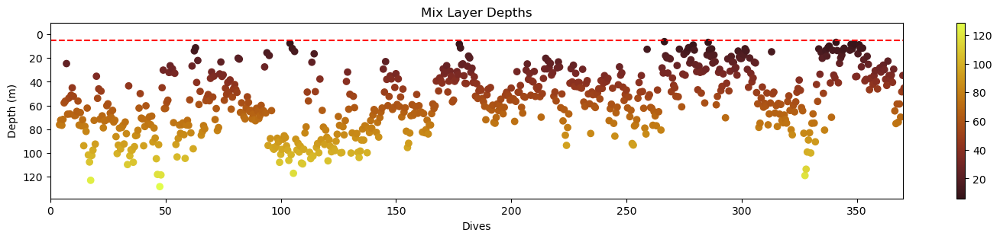

In [17]:
# Plot the mix layer depths for each dive.

plt.figure(figsize=figWindow)
plt.axhline(y=5, color='red', linestyle='--')
#line = plt.plot(diveNums[mixDepths > 0], mixDepths[mixDepths > 0])
scatter = plt.scatter(diveNums[mixDepths > 0], mixDepths[mixDepths > 0], c = mixDepths[mixDepths > 0], cmap = cmo.solar)
cbar = plt.colorbar(scatter)

plt.xlim(xRange)
plt.ylim((max(mixDepths) + 10, - 10))
plt.title('Mix Layer Depths')
plt.xlabel('Dives')
plt.ylabel('Depth (m)')
plt.show()


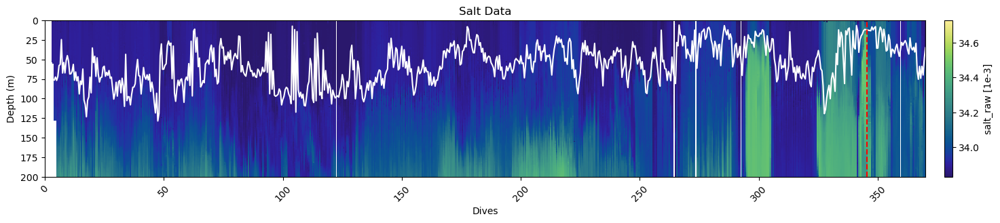

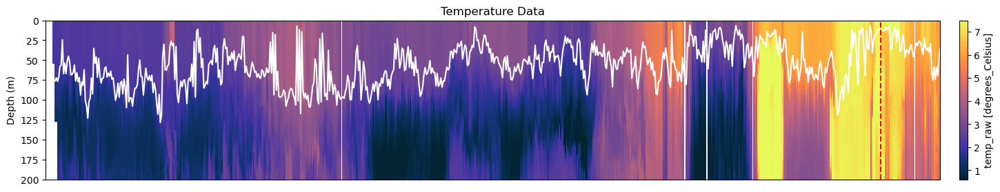

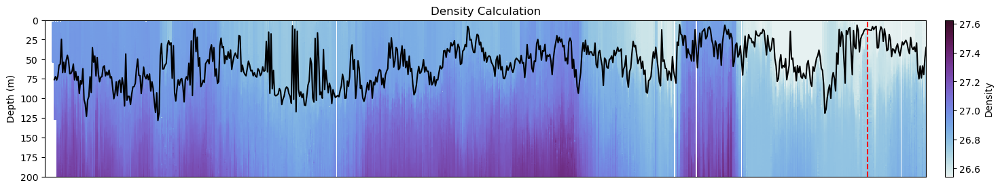

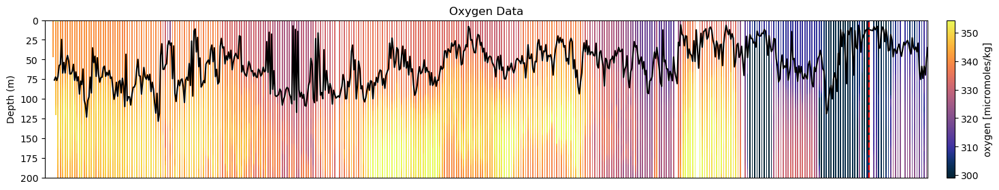

In [18]:
# Create the same Salt/Temperature/etc. plots, but with the Mix Depth Line

# Plot Salt
plt.figure(figsize=figWindow)
gt.plot(x, y, dat.salt_raw, cmap=cmo.haline, robust=True)
mixDepthLine = plt.plot(diveNums[mixDepths > 0], mixDepths[mixDepths > 0], c = 'white')
plt.title('Salt Data')
plt.xlim(xRange)
plt.ylim(200, 0)
plt.axvline(x=345.5, color='red', linestyle='--')
plt.show()

# Plot Temperature
plt.figure(figsize=figWindow)
gt.plot(x, y, dat.temp_raw, cmap=cmo.thermal, robust=True)
mixDepthLine = plt.plot(diveNums[mixDepths > 0], mixDepths[mixDepths > 0], c = 'white')
plt.title('Temperature Data')
plt.xlim(xRange)
plt.ylim(200, 0)
plt.axvline(x=345.5, color='red', linestyle='--')
plt.xticks([])
plt.xlabel("")
plt.show()

# Plot Density
rho = gsw.sigma0(dat.salt_raw, dat.temp_raw)
plt.figure(figsize=figWindow)
ax = gt.plot(x,y, rho, cmap=cmo.dense, robust=True)
cbar = ax.collections[0].colorbar
cbar.set_label('Density')
mixDepthLine = plt.plot(diveNums[mixDepths > 0], mixDepths[mixDepths > 0], c = 'black')
plt.title('Density Calculation')
plt.xlim(xRange)
plt.ylim(200, 0)
plt.axvline(x=345.5, color='red', linestyle='--')
plt.xticks([])
plt.xlabel("")
plt.show()

plt.figure(figsize=figWindow)
gt.plot(x, y, dat.oxygen, cmap=cmo.thermal, robust=True)
mixDepthLine = plt.plot(diveNums[mixDepths > 0], mixDepths[mixDepths > 0], c = 'black')
plt.title('Oxygen Data')
plt.xlim(xRange)
plt.ylim(200, 0)
plt.axvline(x=345.5, color='red', linestyle='--')
plt.xticks([])
plt.xlabel("")
plt.show()


In [19]:
# Calculate the average mix layer value of these features for each dive

mixSalt = []
mixTemps = []
mixDensity = []
mixOxygen = []


for i in np.arange(len(mixDepths)):

    # Get all indices in this dive where the depth is within the mix layer [5, mixDepth]
    indexesWithinDive = np.where((dat.depth.values[diveIndices[i][0] : diveIndices[i][1]] > 5) & (dat.depth.values[diveIndices[i][0] : diveIndices[i][1]] < mixDepths[i]))[0]
    mixLayerIndices = indexesWithinDive + diveIndices[i][0]

    # Calculate all the mix metrics
    mixSalt.append(np.mean(dat.salt_raw.values[mixLayerIndices]))
    mixTemps.append(np.mean(dat.temp_raw.values[mixLayerIndices]))
    rho = gsw.sigma0(dat.salt_raw, dat.temp_raw)
    mixDensity.append(np.mean(rho.values[mixLayerIndices]))
    mixOxygen.append(np.mean(dat.oxygen.values[mixLayerIndices]))
        

mixSalt = np.array(mixSalt)
mixTemps = np.array(mixTemps)
mixDensity = np.array(mixDensity)
mixOxygen = np.array(mixOxygen)

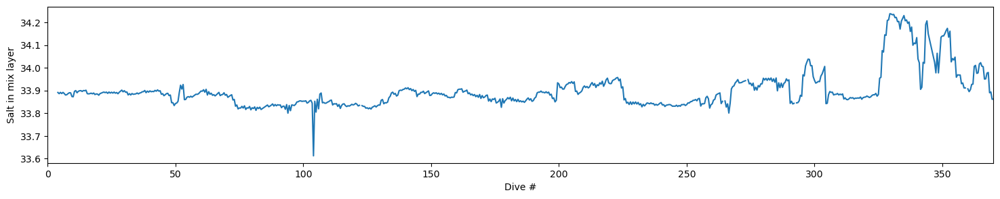

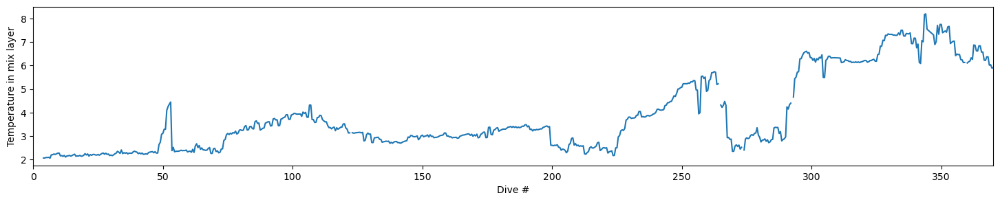

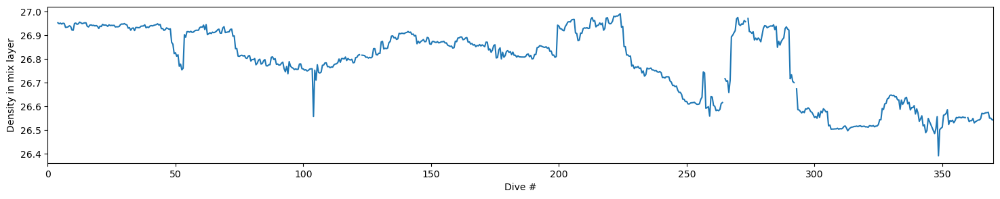

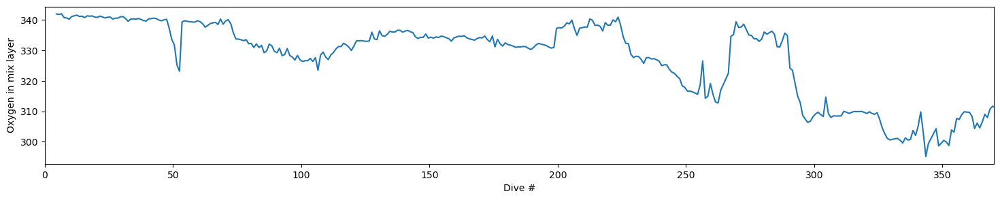

In [20]:
# Plot the above calculations

plt.figure(figsize=figWindow)
plt.xlim(xRange)
mixDepthLine = plt.plot(diveNums, mixSalt)
plt.xlabel("Dive #")
plt.ylabel("Salt in mix layer")
plt.show()

plt.figure(figsize=figWindow)
plt.xlim(xRange)
mixDepthLine = plt.plot(diveNums, mixTemps)
plt.xlabel("Dive #")
plt.ylabel("Temperature in mix layer")
plt.show()

plt.figure(figsize=figWindow)
plt.xlim(xRange)
mixDepthLine = plt.plot(diveNums, mixDensity)
plt.xlabel("Dive #")
plt.ylabel("Density in mix layer")
plt.show()

plt.figure(figsize=figWindow)
plt.xlim(xRange)
mixDepthLine = plt.plot(diveNums[mixOxygen > 0], mixOxygen[mixOxygen > 0])
plt.xlabel("Dive #")
plt.ylabel("Oxygen in mix layer")
plt.show()

# Backscatter plots

In [9]:
# Calculate all the backscatter data

fluorescenceData = (wlbb2fl_dat.chlorophyll_voltage - chlorophyll_darkCounts) * chlorophyll_scaleFactor
backscatterData = (wlbb2fl_dat.backscatter_voltage - backscatter_darkCounts) * backscatter_scaleFactor
cdomData = (wlbb2fl_dat.cdom_voltage - cdom_darkCounts) * cdom_scaleFactor

In [10]:
# Does interpolating the times make sense?
print(len(dat.ctd_time_dt64.values), len(wlbb2fl_dat.wlbb2fl_time_dt64.values))
print(dat.ctd_time_dt64.values[0], dat.ctd_time_dt64.values[-1])
print(wlbb2fl_dat.wlbb2fl_time_dt64.values[0], wlbb2fl_dat.wlbb2fl_time_dt64.values[-1])

876256 175137
2023-11-26T23:26:04.000000000 2024-01-22T16:04:38.000000000
2023-11-26T23:26:06.000000000 2024-01-22T16:04:34.000000000


In [11]:
wlbb2fl_dat

<xarray.Dataset>
Dimensions:              (wlbb2fl_data_point: 175137)
Dimensions without coordinates: wlbb2fl_data_point
Data variables:
    wlbb2fl_time_dt64    (wlbb2fl_data_point) datetime64[ns] 2023-11-26T23:26...
    wlbb2fl_time         (wlbb2fl_data_point) float64 1.701e+09 ... 1.706e+09
    cdom_voltage         (wlbb2fl_data_point) float64 54.0 55.0 ... 56.0 55.0
    backscatter_voltage  (wlbb2fl_data_point) float64 55.0 55.0 ... 94.0 91.0
    chlorophyll_voltage  (wlbb2fl_data_point) float64 283.0 186.0 ... 124.0
    dives                (wlbb2fl_data_point) int32 3 3 3 3 ... 370 370 370 370
Attributes:
    date_created:             2024-05-01 16:10:44
    number_of_dives:          370
    files:                    ['p6590003.nc', 'p6590004.nc', 'p6590005.nc', '...
    time_coverage_start:      2023-11-26 23:26:06
    time_coverage_end:        2024-01-22 16:04:34
    geospatial_vertical_min:  nan
    geospatial_vertical_max:  nan
    geospatial_lat_min:       nan
    geospatial_lat_max:       nan
    geospatial_lon_min:       nan
    geospatial_lon_max:       nan
    processing:               [2024-05-01 16:10:44] imported data with Glider...

wlbb2fl skips deep measurements, so linear won't work

1d interpolation (numpy)

In [88]:
# We should interpolate the ctd Data (dive #, depth in meters) to the wlbb2fl times
interp_dives = np.interp(
    np.linspace(0, 1, len(wlbb2fl_dat.wlbb2fl_time_dt64.values)),
    np.linspace(0, 1, len(dat.ctd_time_dt64.values)),
    dat.dives.values
)
print(interp_dives, len(interp_dives))

interp_depth = np.interp(
    np.linspace(0, 1, len(wlbb2fl_dat.wlbb2fl_time_dt64.values)),
    np.linspace(0, 1, len(dat.ctd_time_dt64.values)),
    dat.depth.values
)
print(interp_depth, len(interp_depth))

[  3.    3.    3.  ... 370.5 370.5 370.5] 175137
[1.39889181 1.40259706 1.62259382 ... 0.18944835 0.16750067 0.25648559] 175137


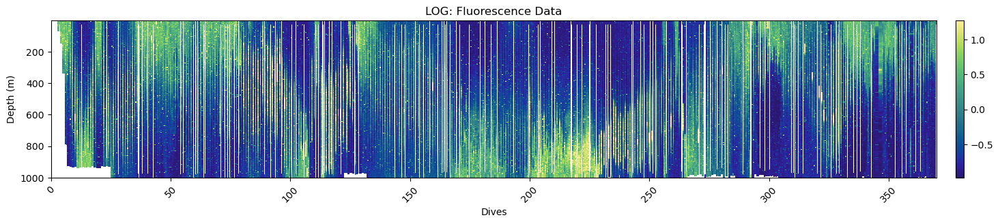

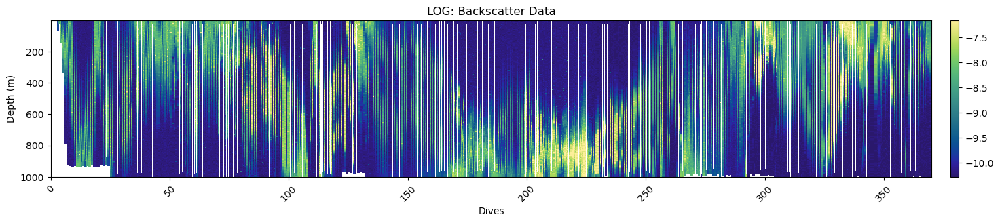

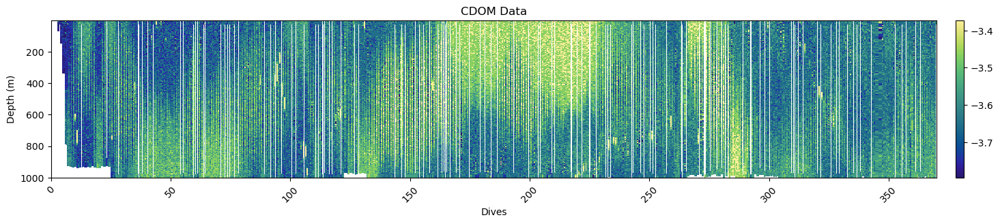

In [99]:
# Plot!

plt.figure(figsize=figWindow)
gt.plot(interp_dives, interp_depth, np.log(fluorescenceData), cmap=cmo.haline, robust=True)
plt.title('LOG: Fluorescence Data')
plt.xlim(xRange)
plt.show()

plt.figure(figsize=figWindow)
gt.plot(interp_dives, interp_depth, np.log(backscatterData), cmap=cmo.haline, robust=True)
plt.title('LOG: Backscatter Data')
plt.xlim(xRange)
plt.show()

plt.figure(figsize=figWindow)
gt.plot(interp_dives, interp_depth, cdomData, cmap=cmo.haline, robust=True)
plt.title('CDOM Data')
plt.xlim(xRange)
plt.show()


# plt.figure(figsize=figWindow)
# plt.scatter(wlbb2fl_dat.wlbb2fl_time_dt64, np.log(fluorescenceData), s=5, c=fluorescenceData, cmap=cmo.matter)
# plt.xticks(rotation = 45)
# plt.xlabel('Date')
# plt.ylabel('Fluorescence')

# plt.figure(figsize=figWindow)
# plt.scatter(wlbb2fl_dat.wlbb2fl_time_dt64, np.log(backscatterData), s=5, c=backscatterData, cmap=cmo.matter)
# plt.xticks(rotation = 45)
# plt.xlabel('Date')
# plt.ylabel('Backscatter')

# plt.figure(figsize=figWindow)
# plt.scatter(wlbb2fl_dat.wlbb2fl_time_dt64, np.log(cdomData), s=5, c=cdomData, cmap=cmo.matter)
# plt.xticks(rotation = 45)
# plt.xlabel('Date')
# plt.ylabel('CDOM')

# SLA animation

In [23]:
# Figure out what range of SLA data from website
print("Longitudes: ", np.min(dat.ctd_time_dt64.longitude.values), " to ", np.max(dat.ctd_time_dt64.longitude.values))
print("Latitudes: ", np.min(dat.ctd_time_dt64.latitude.values), " to ", np.max(dat.ctd_time_dt64.latitude.values))
print("Dates: ", np.min(dat.ctd_time_dt64.values), " to ", np.max(dat.ctd_time_dt64.values))

Longitudes:  151.28540296191383  to  156.6823154697159
Latitudes:  -56.45904329886829  to  -53.179958844058284
Dates:  2023-11-26T23:26:04.000000000  to  2024-01-22T16:04:38.000000000


In [24]:
# Show the variables
# gt.load.seaglider_show_variables(slaFilename)

# Open it with XArray
xr.open_dataset(slaFilename)

<xarray.Dataset>
Dimensions:    (time: 93, latitude: 24, longitude: 32)
Coordinates:
  * latitude   (latitude) float32 -57.88 -57.62 -57.38 ... -52.62 -52.38 -52.12
  * longitude  (longitude) float32 150.1 150.4 150.6 150.9 ... 157.4 157.6 157.9
  * time       (time) datetime64[ns] 2023-11-01 2023-11-02 ... 2024-02-01
Data variables:
    adt        (time, latitude, longitude) float32 ...
    err_sla    (time, latitude, longitude) float32 ...
    err_ugosa  (time, latitude, longitude) float32 ...
    err_vgosa  (time, latitude, longitude) float32 ...
    flag_ice   (time, latitude, longitude) float32 ...
    sla        (time, latitude, longitude) float32 ...
    ugos       (time, latitude, longitude) float32 ...
    ugosa      (time, latitude, longitude) float32 ...
    vgos       (time, latitude, longitude) float32 ...
    vgosa      (time, latitude, longitude) float32 ...
Attributes:
    Conventions:       CF-1.11
    title:             NRT merged all satellites Global Ocean Gridded SSALTO/...
    institution:       CLS, CNES
    source:            Altimetry measurements
    history:           2023-11-24 00:53:07Z: Creation
    contact:           servicedesk.cmems@mercator-ocean.eu
    references:        http://marine.copernicus.eu
    comment:           Sea Surface Height measured by Altimetry and derived v...
    subset:source:     ARCO data downloaded from the Marine Data Store using ...
    subset:productId:  SEALEVEL_GLO_PHY_L4_NRT_008_046
    subset:datasetId:  cmems_obs-sl_glo_phy-ssh_nrt_allsat-l4-duacs-0.25deg_P...
    subset:date:       2024-02-14T05:13:03.106Z

In [12]:
# Load these variables from the files into ds_dict
slaNames = ['latitude', 'longitude', 'sla']
sla_dat = xr.open_dataset(slaFilename)
print(len(sla_dat.time.values))

#sla_dict = gt.load.seaglider_basestation_netCDFs(slaFilename, slaNames)
#sla_dict

93


Text(0, 0.5, 'Latitude')

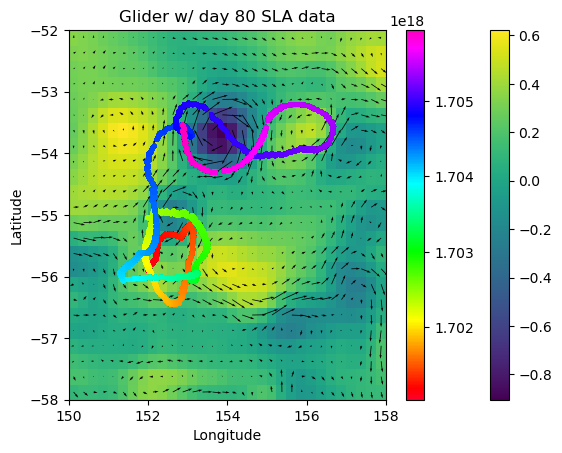

In [101]:
# Not needed - plot one day. Takes 8 seconds to run

day = 80
plt.pcolor(sla_dat.longitude, sla_dat.latitude, sla_dat.sla[day, :, :])
plt.colorbar()
plt.quiver(sla_dat.longitude, sla_dat.latitude, sla_dat.ugos[day, :, :], sla_dat.vgos[day, :, :])

plt.scatter(dat.longitude, dat.latitude, s=5, c = dat.ctd_time_dt64.values, cmap = "gist_rainbow")
plt.colorbar()
plt.title("Glider w/ day 80 SLA data")
plt.xlabel("Longitude")
plt.ylabel("Latitude")

In [13]:
# Get both the SLA dates and the Glider dates in YYYY-MM-DD
slaDates = list(map(lambda x: np.datetime_as_string(x, unit='D'), sla_dat.time.values))
gliderDates = list(map(lambda x: np.datetime_as_string(x, unit='D'), dat.ctd_time_dt64.values))

In [14]:
# Find the indices of the Glider's coordinates for each of the SLA dates (if not available, -1)
gliderIndices = []
lastIndex = 0
found = False
for slaDate in slaDates:
    
    for gliderIndex in np.arange(lastIndex, len(gliderDates)):
        if slaDate == gliderDates[gliderIndex]:
            gliderIndices.append(gliderIndex)
            lastIndex = gliderIndex
            found = True
            break
    
    if not found:
        gliderIndices.append(-1)
    found = False

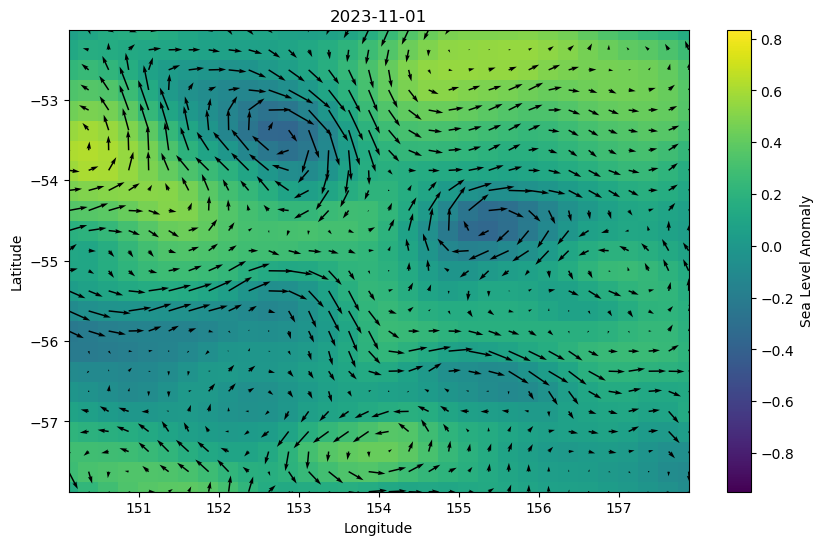

In [115]:
# Make video - not needed every time

# Update by animation frame
def update(frame):

    plt.clf()

    # Labels and scale
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.title(np.datetime_as_string(sla_dat.time.values[frame], unit='D'))
    plt.xlim(sla_dat.longitude.min(), sla_dat.longitude.max())
    plt.ylim(sla_dat.latitude.min(), sla_dat.latitude.max())

    # Plot the SLA data
    plt.pcolor(sla_dat.longitude, sla_dat.latitude, sla_dat.sla[frame, :, :])
    plt.colorbar(label='Sea Level Anomaly')
    plt.clim(sla_dat.sla.min(), sla_dat.sla.max())
    plt.quiver(sla_dat.longitude, sla_dat.latitude, sla_dat.ugos[frame, :, :], sla_dat.vgos[frame, :, :])

    # Plot the glider's position
    if gliderIndices[frame] != -1:
        long = dat.longitude[gliderIndices[frame]]
        lat = dat.latitude[gliderIndices[frame]]
        plt.plot(long, lat, 'ro')
        title = np.datetime_as_string(sla_dat.time.values[frame], unit='D') + " | Approx. Dive:  " + str(int(np.round(dat.dives.values[gliderIndices[frame]], 0)))
        plt.title(title)
    

# Create figure
fig = plt.figure(figsize=(10, 6))

# Create animation
ani = animation.FuncAnimation(fig, update, frames=len(sla_dat.time), interval=500)

# Save animation to file
ani.save('./plots/sla_animation.mp4', fps=5)

# SLA on Glider path

In [15]:
gliderSlas = []

for i in np.arange(len(gliderIndices)):
    sla_date = slaDates[i]

    if gliderIndices[i] != -1:
        gliderIndex = gliderIndices[i]
        gliderLat = dat.latitude.values[gliderIndex]
        gliderLong = dat.longitude.values[gliderIndex]
        slaLat = sla_dat.sel(time = sla_date).latitude.values[
            np.where(np.abs(sla_dat.sel(time = sla_date).latitude.values - gliderLat) < 0.125)[0][0]
        ]
        slaLong = sla_dat.sel(time = sla_date).longitude.values[
            np.where(np.abs(sla_dat.sel(time = sla_date).longitude.values - gliderLong) < 0.125)[0][0]
        ]
        gliderSla = sla_dat.sel(time = sla_date, latitude = slaLat, longitude = slaLong).sla.values
        gliderSlas.append(gliderSla)

        #print(sla_date, gliderIndex, gliderLat, slaLat, gliderLong, slaLong)
    

print(gliderSlas)

    

[array(-0.129, dtype=float32), array(-0.1327, dtype=float32), array(-0.1581, dtype=float32), array(-0.1977, dtype=float32), array(-0.2696, dtype=float32), array(-0.1842, dtype=float32), array(-0.2371, dtype=float32), array(-0.0308, dtype=float32), array(0.0902, dtype=float32), array(0.1017, dtype=float32), array(0.1017, dtype=float32), array(0.0436, dtype=float32), array(0.0266, dtype=float32), array(0.0227, dtype=float32), array(0.048, dtype=float32), array(0.0632, dtype=float32), array(0.1474, dtype=float32), array(0.1951, dtype=float32), array(0.0804, dtype=float32), array(0.0401, dtype=float32), array(-0.1153, dtype=float32), array(-0.2373, dtype=float32), array(-0.2421, dtype=float32), array(-0.1018, dtype=float32), array(0.0834, dtype=float32), array(0.0651, dtype=float32), array(-0.0845, dtype=float32), array(-0.0761, dtype=float32), array(-0.0401, dtype=float32), array(0.062, dtype=float32), array(0.0332, dtype=float32), array(-0.0019, dtype=float32), array(-0.0326, dtype=float

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50,
  51,
  52,
  53,
  54,
  55,
  56,
  57],
 [Text(0, 0, '2023-11-26'),
  Text(1, 0, '2023-11-27'),
  Text(2, 0, '2023-11-28'),
  Text(3, 0, '2023-11-29'),
  Text(4, 0, '2023-11-30'),
  Text(5, 0, '2023-12-01'),
  Text(6, 0, '2023-12-02'),
  Text(7, 0, '2023-12-03'),
  Text(8, 0, '2023-12-04'),
  Text(9, 0, '2023-12-05'),
  Text(10, 0, '2023-12-06'),
  Text(11, 0, '2023-12-07'),
  Text(12, 0, '2023-12-08'),
  Text(13, 0, '2023-12-09'),
  Text(14, 0, '2023-12-10'),
  Text(15, 0, '2023-12-11'),
  Text(16, 0, '2023-12-12'),
  Text(17, 0, '2023-12-13'),
  Text(18, 0, '2023-12-14'),
  Text(19, 0, '2023-12-15'),
  Text(20, 0, '2023-12-16'),
  Text(21, 0, '2023-12-17'),
  Text(22, 0, '2023-12-18'),
  Te

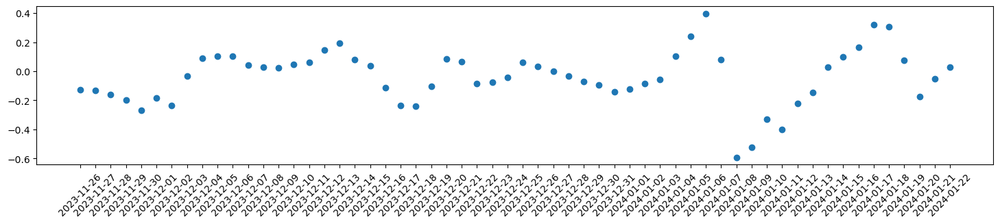

In [18]:
plt.figure(figsize=figWindow)
plt.scatter(np.unique(gliderDates), gliderSlas)
plt.xticks(rotation = 45)

In [36]:
# Making a function to get the value in the array closest to the given value
def nearestValInArray(value, array):
    return array[np.argmin(np.abs(array - value))]

def binarySearchNearestVal(value, array):
    idx = np.searchsorted(array, value)
    if idx == 0:
        return array[0]
    elif idx == len(array):
        return array[-1]
    else:
        before = array[idx - 1]
        after = array[idx]
        return before if (after - value > value - before) else after


In [37]:
testArray = np.array([1, 2, 3, 4, 5])

print(
    nearestValInArray(3.3, testArray),
    binarySearchNearestVal(3.3, testArray)
)

3 3


In [40]:
sla_dat.sel(time = str(dat.ctd_time_dt64.values[2])[0:10]).longitude.values

array([150.125, 150.375, 150.625, 150.875, 151.125, 151.375, 151.625,
       151.875, 152.125, 152.375, 152.625, 152.875, 153.125, 153.375,
       153.625, 153.875, 154.125, 154.375, 154.625, 154.875, 155.125,
       155.375, 155.625, 155.875, 156.125, 156.375, 156.625, 156.875,
       157.125, 157.375, 157.625, 157.875], dtype=float32)

In [41]:
sla_dat.sel(time = str(dat.ctd_time_dt64.values[2])[0:10], longitude = 150.375).latitude.values

array([-57.875, -57.625, -57.375, -57.125, -56.875, -56.625, -56.375,
       -56.125, -55.875, -55.625, -55.375, -55.125, -54.875, -54.625,
       -54.375, -54.125, -53.875, -53.625, -53.375, -53.125, -52.875,
       -52.625, -52.375, -52.125], dtype=float32)

In [20]:
len(dat.dives.values)

876256

In [54]:
a, b = 2, 3
print(a)
print(b)

2
3


In [64]:
# For each dive, get SLA at that lat-long
gliderSlas = []
lastSLA, lastLong, lastLat, lastDate = None, None, None, None

iterator = np.nditer([dat.longitude.values, dat.latitude.values, dat.ctd_time_dt64.values])

# This for-loop used to take 19 minutes with a search every time. 
# Now that we optimize for position, it takes 3.1 seconds! This is possible because the glider moves slowly on a coarse-satellite-imagery scale.

for gliderLong, gliderLat, gliderDate in iterator:

    thisDate = str(gliderDate)[0:10]
    
    # Are we at the same position?
    if lastSLA is None:
        samePosition = False
    else:
        samePosition = True if ((np.abs(lastLat - gliderLat) < 0.25) and (np.abs(lastLong - gliderLong) < 0.25) and (lastDate == thisDate)) else False

    # If we're at the same position, no need for expensive calculations.
    if samePosition:
        sla = lastSLA
    else:
        approxLong = nearestValInArray(gliderLong, sla_dat.sel(time = thisDate).longitude.values)
        approxLat = nearestValInArray(gliderLat, sla_dat.sel(time = thisDate, longitude = approxLong).latitude.values)
        sla = sla_dat.sel(time = str(gliderDate)[0:10], longitude = approxLong, latitude = approxLat).sla.values
        lastSLA, lastLong, lastLat, lastDate = sla, approxLong, approxLat, thisDate

    gliderSlas.append(sla)

    if len(gliderSlas) % 100000 == 0:
        print(len(gliderSlas))

# for i in np.arange(len(dat.dives.values)):
#     gliderLong = dat.longitude.values[i]
#     gliderLat = dat.latitude.values[i]
#     gliderDate = str(dat.ctd_time_dt64.values[i])[0:10]
        
# for gliderLong, gliderLat, gliderDate in zip(dat.longitude.values, dat.latitude.values, dat.ctd_time_dt64.values):
#     slaTime = np.argmin(np.abs(sla_dat.time.values - gliderDate))
#     approxLongIndex = np.argmin(np.abs(sla_dat.longitude.values - gliderLong))
#     approxLatIndex = np.argmin(np.abs(sla_dat.latitude.values - gliderLat))
#     sla = sla_dat.sla.values[slaTime, approxLongIndex, approxLatIndex] 

100000
200000
300000
400000
500000
600000
700000
800000


Text(0, 0.5, 'Sea Level Anomaly')

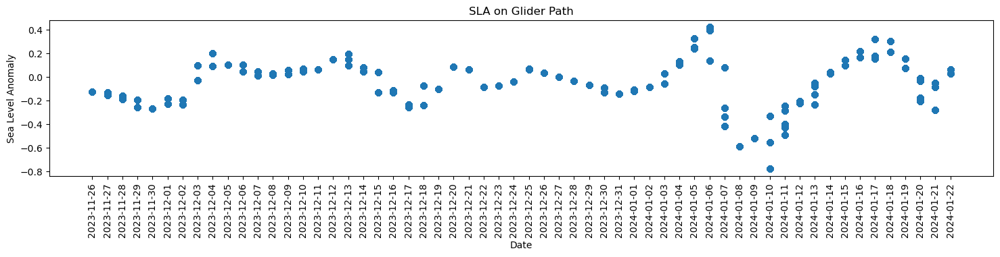

In [65]:
plt.figure(figsize=figWindow)
plt.scatter(gliderDates, gliderSlas)
plt.xticks(rotation = 90)
plt.title("SLA on Glider Path")
plt.xlabel("Date")
plt.ylabel("Sea Level Anomaly")

# plt.figure(figsize=figWindow)
# plt.xlim(xRange)
# mixDepthLine = plt.plot(diveNums[mixTemps > 0], mixTemps[mixTemps > 0])
# plt.xlabel("Dive #")
# plt.ylabel("Temperature in mix layer")
# plt.show()

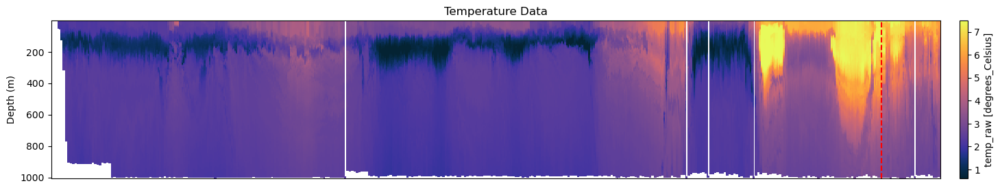

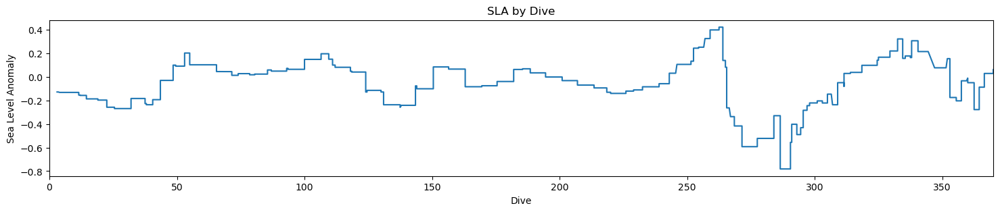

In [63]:
# Plot Temperature
plt.figure(figsize=figWindow)
gt.plot(x, y, dat.temp_raw, cmap=cmo.thermal, robust=True)
plt.title('Temperature Data')
plt.xlim(xRange)
plt.axvline(x=345.5, color='red', linestyle='--')
plt.xticks([])
plt.xlabel("")
plt.show()

# Plot SLA
plt.figure(figsize=figWindow)
plt.plot(x, gliderSlas)
plt.title('SLA by Dive')
plt.xlabel('Dive')
plt.ylabel('Sea Level Anomaly')
#plt.colorbar()
plt.xlim(xRange)
#plt.axvline(x=345.5, color='red', linestyle='--')
#plt.xticks([])
#plt.xlabel("")
plt.show()

# Other plots

In [24]:
# A cool 3d plot

gt.plot.section3D(dat.dives, dat.depth, dat.longitude, dat.latitude, dat.temp_raw, cmap=cmo.haline)

In [1]:
# Quality control on Oxygen
valid_indices = ~np.isnan(dat.oxygen.values)
oxygen_valid = dat.oxygen.values[valid_indices]
oxygen_mean = np.mean(oxygen_valid)
oxygen_transformed = np.nan_to_num(dat.oxygen, nan=oxygen_mean)

xLims = (270, 370)

plt.figure(figsize=figWindow)
gt.plot(x, y, oxygen_transformed, cmap=cmo.thermal, robust=True)
plt.title('Quality control on Oxygen Data')
plt.xlim(xLims)
plt.axvline(x=345.5, color='red', linestyle='--')

NameError: name 'np' is not defined

# Notes

- % Saturation - gsw for temperature, oxygen --> % saturation - make the same depth/dive plot: which function is this? Oxygen solubility: gsw.O2sol(SA, CT, p, lon, lat). % Saturation: (Measured oxygen / that) * 100
- density contours on top of salinity/temp, correlation
- Merge the backscatter data together ^^
- Get more/newer SLA data (larger picture)
- Later - look at ADT

Mix Layer note - not sure what this is referring to?
- Plot: X axis for Salinity, Y axis for Temperature
- Nonlinear density contours (see picture)
- Pick a few columns